# Accelerometer Preprocessing and Transforming

In [1]:
import pandas as pd
import numpy as np
from scipy.signal import butter, filtfilt, firwin, lfilter, freqz
import matplotlib.pyplot as plt
from scipy.signal.windows import hamming
from spectrum import pburg

In [2]:
raw_data_path = '/Users/patriciawatanabe/Projects/Neurotech/NTUT25_Software/data/accelerometer/raw/801_1_accelerometer.pkl'

In [3]:
# Load the raw accelerometer data
try:
    # Load the data, which is a numpy array
    accel_data_array = pd.read_pickle(raw_data_path)
    # Transpose the array to ensure columns correspond to axes (x, y, z)
    # The original shape is (3, 93501), so we transpose it to (93501, 3)
    accel_data_array = accel_data_array.T
    # Convert the transposed array to a pandas DataFrame with x, y, z columns
    df_accel = pd.DataFrame(accel_data_array, columns=['x', 'y', 'z'])
    print("Data loaded, transposed, and converted to DataFrame successfully.")
    print(df_accel.head())
    
except FileNotFoundError:
    print(f"Error: The file at {raw_data_path} was not found.")
    df_accel = None

Data loaded, transposed, and converted to DataFrame successfully.
             x             y            z
0  623823.3750 -9.969514e+05 -935598.0000
1  620121.9375 -9.979850e+05 -938785.6875
2  618349.6250 -1.001284e+06 -942259.4375
3  616810.9375 -1.005281e+06 -945407.1250
4  614162.6875 -1.008645e+06 -949929.6250


In [4]:
# Convert the entire DataFrame to float64 to ensure accurate calculations
if df_accel is not None:
    df_accel = df_accel.astype(np.float64)
    print("\nDataFrame converted to float64 data type.")
    print(df_accel.head())


DataFrame converted to float64 data type.
             x             y            z
0  623823.3750 -9.969514e+05 -935598.0000
1  620121.9375 -9.979850e+05 -938785.6875
2  618349.6250 -1.001284e+06 -942259.4375
3  616810.9375 -1.005281e+06 -945407.1250
4  614162.6875 -1.008645e+06 -949929.6250


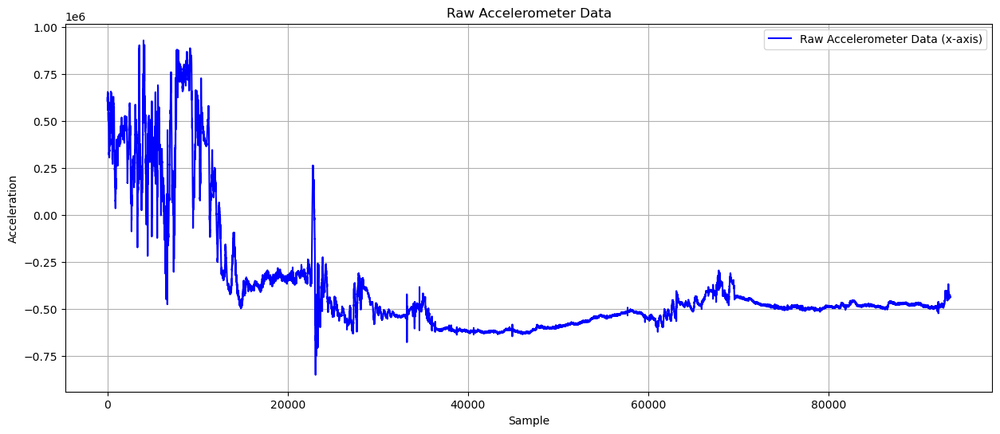

In [5]:
if df_accel is not None:
    plt.figure(figsize=(15, 6))
    plt.plot(df_accel['x'], label='Raw Accelerometer Data (x-axis)', color='blue')
    plt.title('Raw Accelerometer Data')
    plt.xlabel('Sample')
    plt.ylabel('Acceleration')
    plt.legend()
    plt.grid(True)
    plt.show()

In [6]:
# We'll use a window size of 500 samples (5 seconds at 100 Hz)
moving_average_window = 500

# Calculate the moving average for each axis
moving_average = df_accel.rolling(window=moving_average_window, center=True).mean()

# Subtract the moving average from the calibrated data to remove drift
df_no_drift = df_accel - moving_average

# Drop the NaN values that result from the moving average calculation at the edges
df_no_drift = df_no_drift.dropna()

print("Drift removed from the data. First 5 rows of the new DataFrame:")
print(df_no_drift.head())

Drift removed from the data. First 5 rows of the new DataFrame:
                 x              y              z
250  -81730.286125    6689.587500 -153300.190000
251  -57997.090500  -33121.136625 -139961.825375
252  -43905.747688 -129845.143875 -123686.522125
253  -77284.225750 -271226.289750 -153724.605875
254 -124019.119125 -346936.119500 -216401.125750


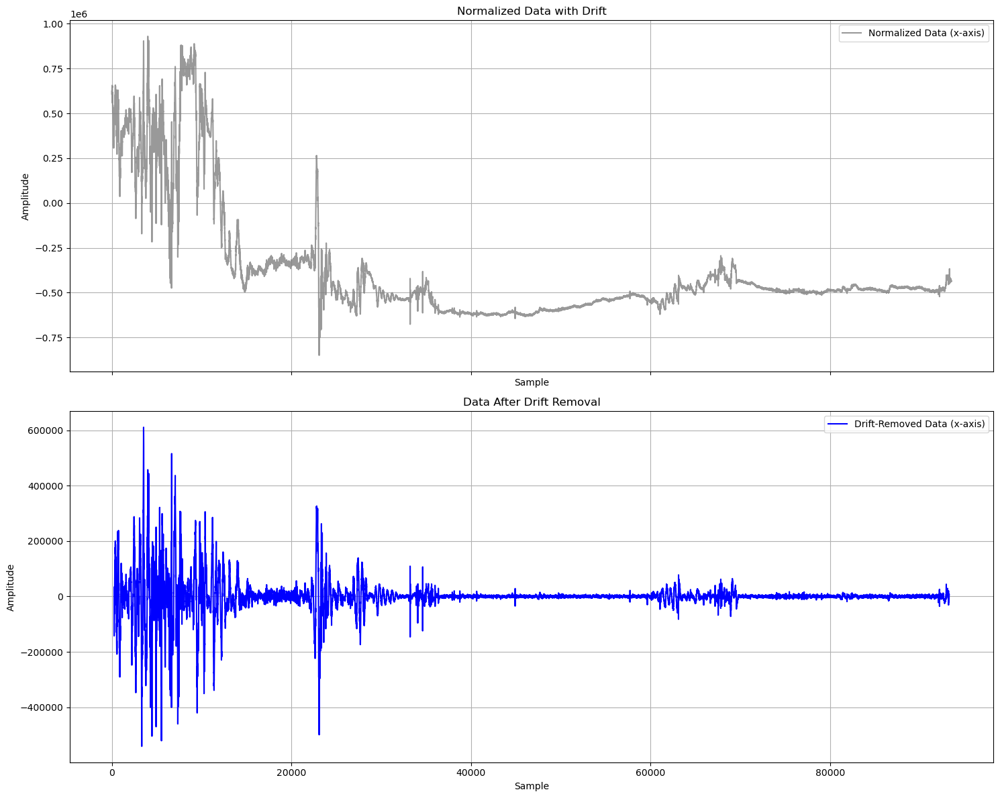

In [7]:
# Assuming df_accel is raw DataFrame
# and df_no_drift is your drift-removed DataFrame

if df_no_drift is not None and df_accel is not None:
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(15, 12), sharex=True)

    # Plot 1: Normalized data with drift
    ax1.plot(df_accel['x'], label='Normalized Data (x-axis)', color='gray', alpha=0.8)
    ax1.set_title('Normalized Data with Drift')
    ax1.set_xlabel('Sample')
    ax1.set_ylabel('Amplitude')
    ax1.legend()
    ax1.grid(True)
    
    # Plot 2: Data with drift removed
    ax2.plot(df_no_drift['x'], label='Drift-Removed Data (x-axis)', color='blue')
    ax2.set_title('Data After Drift Removal')
    ax2.set_xlabel('Sample')
    ax2.set_ylabel('Amplitude')
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

In [8]:
# Filter parameters from the paper
lowcut = 1.0  # Hz
highcut = 30.0 # Hz
fs = 100.0    # Sampling frequency in Hz
order = 100   # FIR filter order --> Not sure proof of concept

def fir_bandpass_filter_filtfilt(data, lowcut, highcut, fs, order):
    """
    Designs and applies a bandpass FIR filter using filtfilt for a zero-phase response.
    
    Args:
        data (pd.DataFrame): The input data to filter.
        lowcut (float): The low cutoff frequency in Hz.
        highcut (float): The high cutoff frequency in Hz.
        fs (float): The sampling frequency in Hz.
        order (int): The filter order.
    
    Returns:
        pd.DataFrame: The filtered data.
    """
    # nyquist = 0.5 * fs
    b = firwin(order + 1, [lowcut, highcut], pass_zero=False, fs=fs)
    
    # Apply the filter using filtfilt
    y = filtfilt(b, 1.0, data.values, axis=0)
    
    # Convert the filtered array back to a DataFrame with the same columns
    df_filtered_fir = pd.DataFrame(y, columns=data.columns)
    
    return df_filtered_fir

if df_no_drift is not None:
    df_filtered_fir = fir_bandpass_filter_filtfilt(df_no_drift, lowcut, highcut, fs, order)
    print("Data filtered successfully with a zero-phase FIR filter.")
    print(df_filtered_fir.head())

Data filtered successfully with a zero-phase FIR filter.
              x              y             z
0  -1972.245801     161.427440  -3699.309893
1  22603.888668  -38698.910212  18345.339070
2  26029.148318 -142962.438389  31374.476291
3  -5715.321007 -282398.644486  11300.988774
4 -53871.785091 -359443.851294 -45761.329400


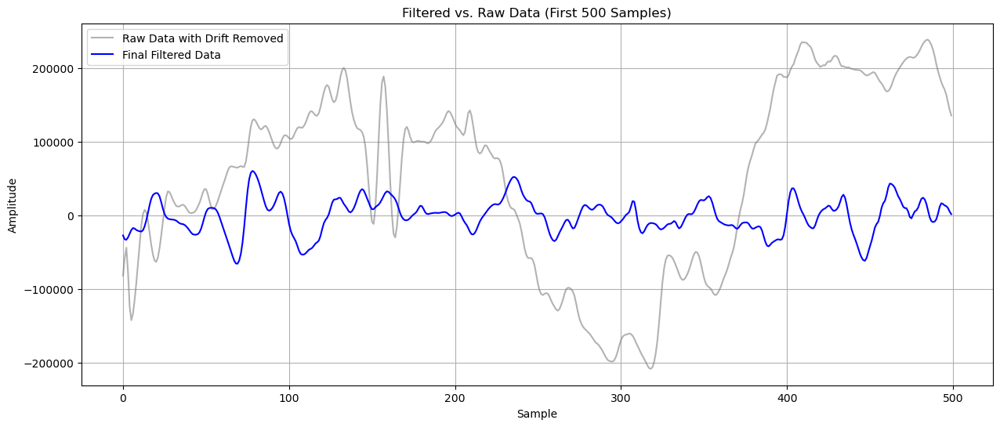

In [9]:
import matplotlib.pyplot as plt

# Get the starting index of the df_no_drift DataFrame
start_index = df_no_drift.index[0]

# Plot the two signals for the first 500 samples
plt.figure(figsize=(15, 6))
plt.plot(df_no_drift['x'].values[:500], label='Raw Data with Drift Removed', color='gray', alpha=0.6)
plt.plot(df_filtered_fir['x'].values[start_index:start_index+500], label='Final Filtered Data', color='blue')

plt.title('Filtered vs. Raw Data (First 500 Samples)')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()
plt.grid(True)
plt.show()

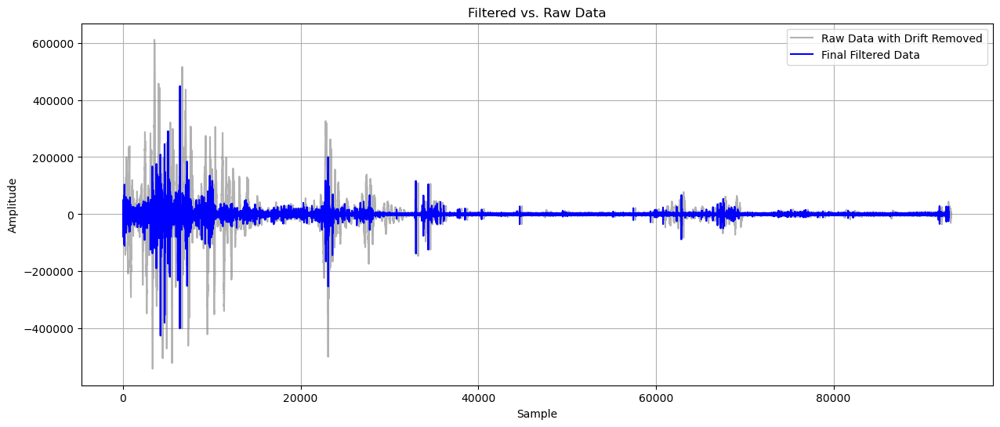

In [10]:
# Plot the two signals for the first 500 samples
plt.figure(figsize=(15, 6))
plt.plot(df_no_drift['x'], label='Raw Data with Drift Removed', color='gray', alpha=0.6)
plt.plot(df_filtered_fir['x'], label='Final Filtered Data', color='blue')

plt.title('Filtered vs. Raw Data')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()
plt.grid(True)
plt.show()

In [11]:
# Parameters from the paper
fs = 100.0  # Sampling frequency in Hz
window_duration = 3.0  # seconds
overlap_ratio = 0.90

# Calculate window and step sizes in samples
window_samples = int(window_duration * fs)
overlap_samples = int(overlap_ratio * window_samples)
step_samples = window_samples - overlap_samples

# Check the calculated values
print(f"Window size: {window_samples} samples")
print(f"Overlap: {overlap_samples} samples")
print(f"Step size: {step_samples} samples")

Window size: 300 samples
Overlap: 270 samples
Step size: 30 samples


In [12]:
def apply_sliding_window(data_series, window_samples, step_samples):
    """
    Applies a sliding Hamming window to a time series.
    
    Args:
        data_series (pd.Series): The time series data for one axis.
        window_samples (int): The number of samples in each window.
        step_samples (int): The number of samples to step for each window.

    Returns:
        list: A list of NumPy arrays, where each array is a windowed segment.
    """
    windowed_segments = []
    
    # Create the Hamming window array
    ham_window = hamming(window_samples, sym=True)
    
    # Iterate through the data with the specified step size
    for i in range(0, len(data_series) - window_samples + 1, step_samples):
        segment = data_series[i : i + window_samples].values
        # Apply the Hamming window element-wise
        windowed_segment = segment * ham_window
        windowed_segments.append(windowed_segment)
        
    return windowed_segments

# Apply windowing to each filtered axis
if df_filtered_fir is not None:
    windowed_data = {}
    for axis in ['x', 'y', 'z']:
        windowed_data[axis] = apply_sliding_window(df_filtered_fir[axis], window_samples, step_samples)
        
    print("\nWindowing completed for all axes.")
    print(f"Number of windows for x-axis: {len(windowed_data['x'])}")
    print(f"Shape of the first window: {windowed_data['x'][0].shape}")
    print(f"Shape of thes second window: {windowed_data['x'][1].shape}")


Windowing completed for all axes.
Number of windows for x-axis: 3091
Shape of the first window: (300,)
Shape of thes second window: (300,)


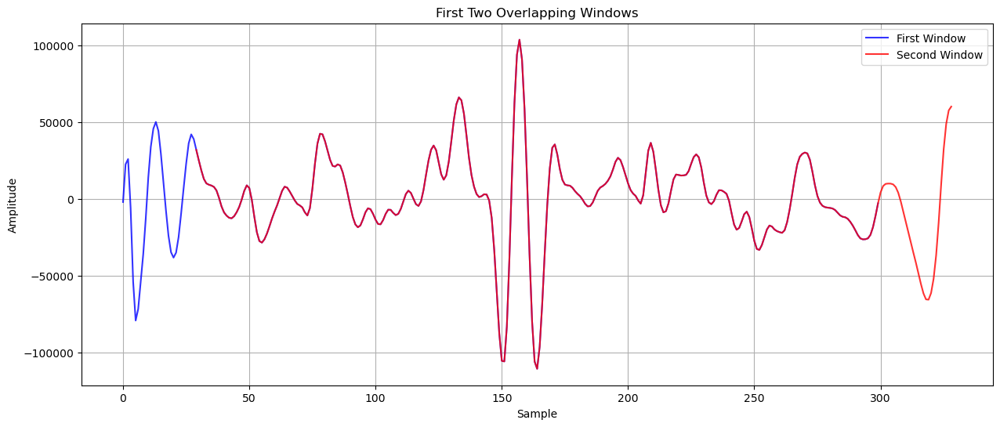

In [13]:
# We assume df_filtered_fir is available from a previous step
if 'df_filtered_fir' in locals() and df_filtered_fir is not None:
    
    # Windowing parameters
    window_samples = 300
    overlap_ratio = 0.90
    step_samples = int(window_samples * (1 - overlap_ratio))
    
    # Get the data for the first two windows
    first_window = df_filtered_fir['x'].values[0:window_samples]
    second_window = df_filtered_fir['x'].values[step_samples:step_samples + window_samples]
    
    # Create the time axis for the plot
    time_first = np.arange(0, window_samples)
    time_second = np.arange(step_samples, step_samples + window_samples)
    
    # Plot the two windows to show the overlap
    plt.figure(figsize=(15, 6))
    plt.plot(time_first, first_window, label='First Window', color='blue', alpha=0.8)
    plt.plot(time_second, second_window, label='Second Window', color='red', alpha=0.8)
    
    plt.title('First Two Overlapping Windows')
    plt.xlabel('Sample')
    plt.ylabel('Amplitude')
    plt.grid(True)
    plt.legend()
    plt.show()

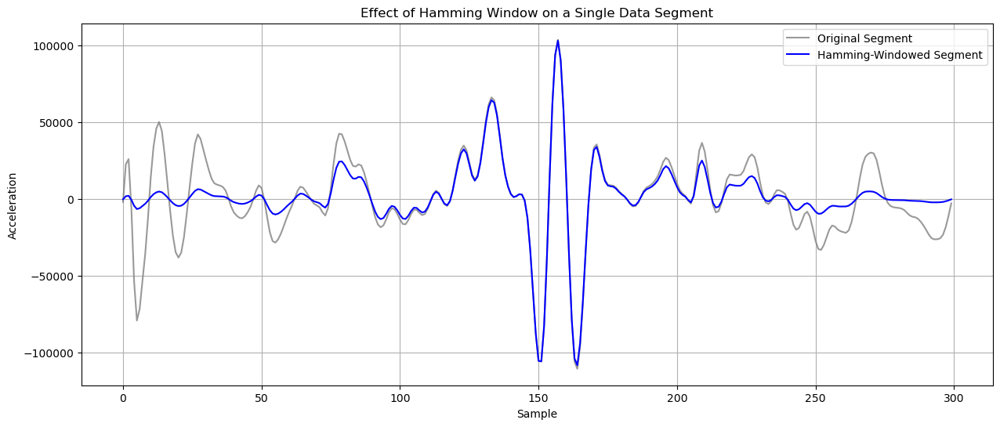

In [14]:
# Get the first segment of the filtered data before windowing
first_segment = df_filtered_fir['x'].values[0:window_samples]

# Apply the Hamming window to this segment
first_windowed_segment = first_segment * hamming(window_samples, sym=True)

# Plot both the original and windowed segments for comparison
plt.figure(figsize=(15, 6))
plt.plot(first_segment, label='Original Segment', color='gray', alpha=0.8)
plt.plot(first_windowed_segment, label='Hamming-Windowed Segment', color='blue')
plt.title('Effect of Hamming Window on a Single Data Segment')
plt.xlabel('Sample')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(True)
plt.show()

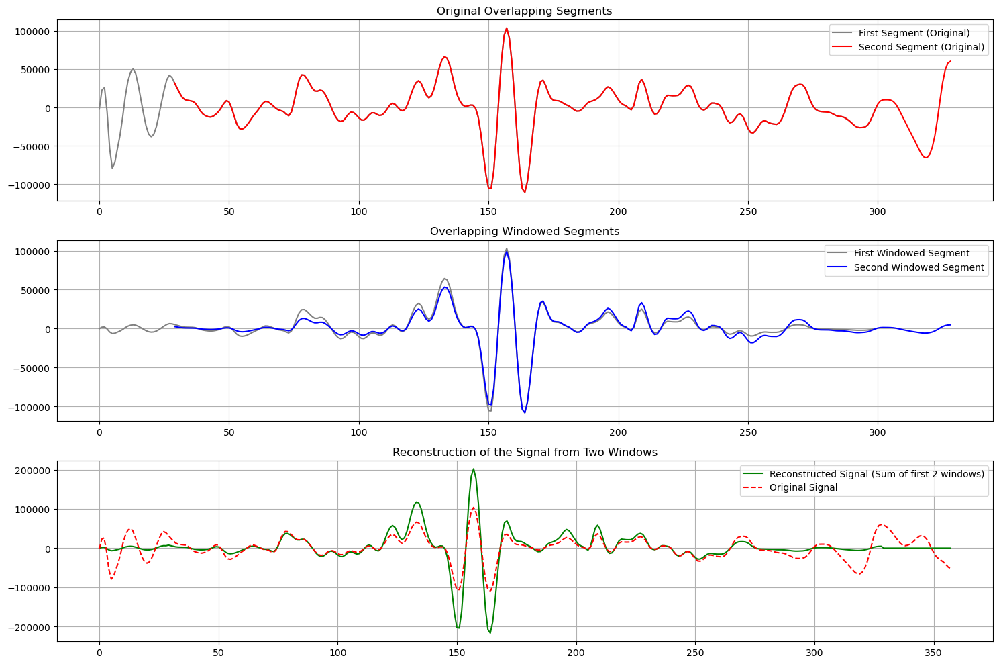

In [15]:
# Get the first three windows from your filtered data for visualization
first_window = df_filtered_fir['x'].values[0:window_samples]
second_window = df_filtered_fir['x'].values[step_samples:step_samples + window_samples]
third_window = df_filtered_fir['x'].values[2*step_samples:2*step_samples + window_samples]

# Create the Hamming window array
ham_window = hamming(window_samples, sym=True)

# Apply the window to each segment
first_windowed = first_window * ham_window
second_windowed = second_window * ham_window
third_windowed = third_window * ham_window

# Plot the individual windows and their interaction
plt.figure(figsize=(15, 10))

# Plot 1: First and second raw segments
plt.subplot(3, 1, 1)
plt.plot(np.arange(0, window_samples), first_window, label='First Segment (Original)', color='gray')
plt.plot(np.arange(step_samples, step_samples + window_samples), second_window, label='Second Segment (Original)', color='red')
plt.title('Original Overlapping Segments')
plt.legend()
plt.grid(True)

# Plot 2: First and second windowed segments
plt.subplot(3, 1, 2)
plt.plot(np.arange(0, window_samples), first_windowed, label='First Windowed Segment', color='gray')
plt.plot(np.arange(step_samples, step_samples + window_samples), second_windowed, label='Second Windowed Segment', color='blue')
plt.title('Overlapping Windowed Segments')
plt.legend()
plt.grid(True)

# Plot 3: A simple reconstruction of the first two windowed segments
# This shows how the overlap recovers the tapered data
plt.subplot(3, 1, 3)
reconstructed_signal = np.zeros(2 * step_samples + window_samples)
reconstructed_signal[0:window_samples] += first_windowed
reconstructed_signal[step_samples:step_samples + window_samples] += second_windowed

plt.plot(reconstructed_signal, label='Reconstructed Signal (Sum of first 2 windows)', color='green')
plt.plot(np.arange(0, 2 * step_samples + window_samples), df_filtered_fir['x'].values[0:2 * step_samples + window_samples], label='Original Signal', linestyle='--', color='red')
plt.title('Reconstruction of the Signal from Two Windows')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [16]:
def reconstruct_signal(data_series, window_samples, step_samples):
        total_length = len(data_series)
        reconstructed_signal = np.zeros(total_length)
        sum_of_windows = np.zeros(total_length)
        
        # Iterate through segments and sum them up
        for i in range(0, total_length - window_samples + 1, step_samples):
            segment = data_series.values[i : i + window_samples]
            windowed_segment = segment * ham_window
            reconstructed_signal[i : i + window_samples] += windowed_segment
            sum_of_windows[i : i + window_samples] += ham_window
        
        # Avoid division by zero
        sum_of_windows[sum_of_windows == 0] = 1e-6
        
        # Normalize the signal by the sum of overlapping windows
        reconstructed_signal /= sum_of_windows
        
        return reconstructed_signal

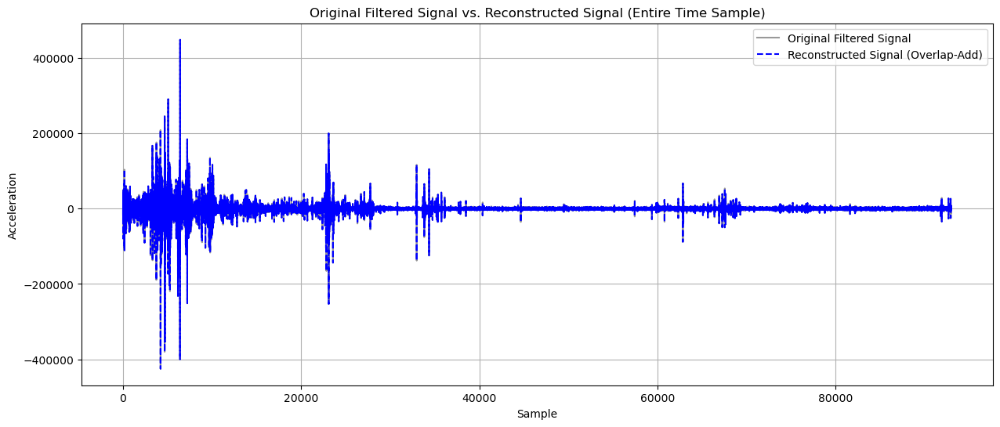

In [17]:
# Reconstruct the signal for the x-axis
reconstructed_signal_x = reconstruct_signal(df_filtered_fir['x'], window_samples, step_samples)

# Plot the original vs. reconstructed signal
plt.figure(figsize=(15, 6))
plt.plot(df_filtered_fir['x'], label='Original Filtered Signal', color='gray', alpha=0.8)
plt.plot(reconstructed_signal_x, label='Reconstructed Signal (Overlap-Add)', color='blue', linestyle='--')
plt.title('Original Filtered Signal vs. Reconstructed Signal (Entire Time Sample)')
plt.xlabel('Sample')
plt.ylabel('Acceleration')
plt.legend()
plt.grid(True)
plt.show()

In [17]:
# Get the first segment from the x-axis
segment = windowed_data['x'][0]

# Print the values and stats of the segment
print("First 10 values of the segment:")
print(segment[:10])
print("\nStats of the segment:")
print(f"Max value: {np.max(segment):.4f}")
print(f"Min value: {np.min(segment):.4f}")
print(f"Mean value: {np.mean(segment):.4f}")

First 10 values of the segment:
[ -157.77966408  1810.60677883  2092.90493815  -462.44825327
 -4397.23530693 -6536.81566942 -5998.07094512 -4546.72426628
 -3106.49163089 -1114.38744678]

Stats of the segment:
Max value: 103223.1878
Min value: -108324.2906
Mean value: 1515.0112


PSD calculation completed.
Example result for the first window on the x-axis:
Global Peak Frequency: 1.00 Hz
Global Peak Power: nan
Label: non-tremor


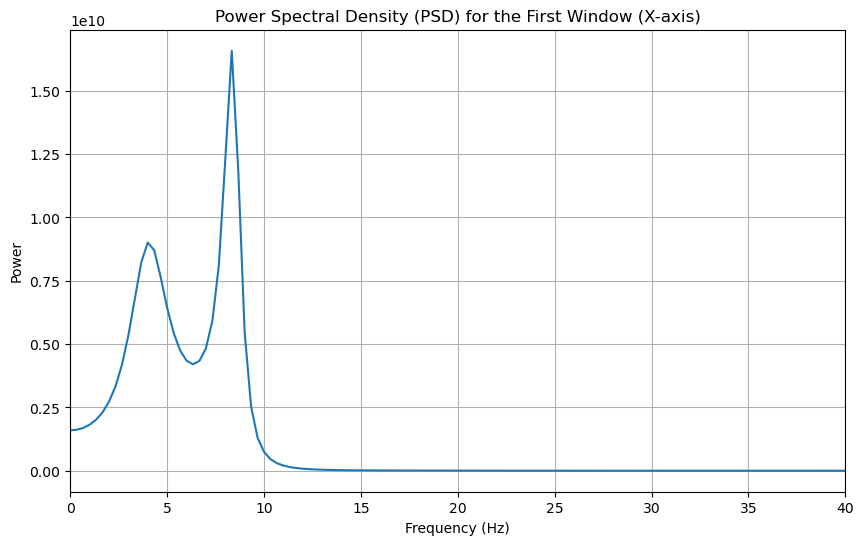

In [18]:
# Define the function to calculate the PSD using the Berg method
def calculate_psd_berg(segment, fs, order):
    """
    Calculates the Power Spectral Density (PSD) using the Berg method.
    """
    p = pburg(segment, order=order, scale_by_freq=False)
    psd_vals = p.psd
    freqs = np.array(p.frequencies()) * fs
    return psd_vals, freqs

# Parameters for PSD calculation
fs = 100.0
order = 6

if 'windowed_data' in locals() and windowed_data:
    psd_results = {}
    
    for axis in ['x', 'y', 'z']:
        psd_results[axis] = []
        for segment in windowed_data[axis]:
            psd_vals, freqs = calculate_psd_berg(segment, fs, order)
            
            # Find the global peak power and its corresponding frequency in the entire spectrum
            peak_power_index = np.argmax(psd_vals)
            global_peak_freq = freqs[peak_power_index]
            global_peak_power = psd_vals[peak_power_index]
            
            label = 'non-tremor'
            
            # Check if the global peak is within the 3-8 Hz tremor range
            if 3.0 <= global_peak_freq <= 8.0:
                peak_freq = global_peak_freq
                peak_power = global_peak_power
                label = 'tremor'
            else:
                peak_freq = 1.0
                peak_power = np.nan
            
            psd_results[axis].append({
                'psd': psd_vals,
                'freqs': freqs,
                'peak_freq': peak_freq,
                'peak_power': peak_power,
                'label': label
            })
            
print("PSD calculation completed.")
print("Example result for the first window on the x-axis:")
print(f"Global Peak Frequency: {psd_results['x'][0]['peak_freq']:.2f} Hz")
print(f"Global Peak Power: {psd_results['x'][0]['peak_power']:.2f}")
print(f"Label: {psd_results['x'][0]['label']}")

# Plot the PSD of the first window for visualization
plt.figure(figsize=(10, 6))
plt.plot(psd_results['x'][0]['freqs'], psd_results['x'][0]['psd'])
plt.title('Power Spectral Density (PSD) for the First Window (X-axis)')
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power')
plt.xlim(0, 40)
plt.grid(True)
plt.show()

In [19]:
# Create a list to hold the data for the DataFrame
data_list = []

# Iterate through each axis and each segment to extract the results
for axis in ['x', 'y', 'z']:
    for i, result in enumerate(psd_results[axis]):
        data_list.append({
            'segment_id': i,
            'axis': axis,
            'peak_freq_Hz': result['peak_freq'],
            'peak_power': result['peak_power'],
            'label': result['label']
        })

# Create the DataFrame
df_features = pd.DataFrame(data_list)

print("DataFrame created successfully.")
print("\nFirst 5 rows of the DataFrame:")
print(df_features.head())
print("\nLast 5 rows of the DataFrame:")
print(df_features.tail())
print("\nDataFrame Shape:", df_features.shape)

DataFrame created successfully.

First 5 rows of the DataFrame:
   segment_id axis  peak_freq_Hz    peak_power       label
0           0    x      1.000000           NaN  non-tremor
1           1    x      1.000000           NaN  non-tremor
2           2    x      1.000000           NaN  non-tremor
3           3    x      3.333333  4.791050e+09      tremor
4           4    x      3.000000  8.571837e+09      tremor

Last 5 rows of the DataFrame:
      segment_id axis  peak_freq_Hz    peak_power   label
9268        3086    z      3.666667  1.881440e+08  tremor
9269        3087    z      4.000000  2.090844e+08  tremor
9270        3088    z      4.000000  2.106365e+08  tremor
9271        3089    z      4.000000  2.029591e+08  tremor
9272        3090    z      3.666667  2.108777e+08  tremor

DataFrame Shape: (9273, 5)


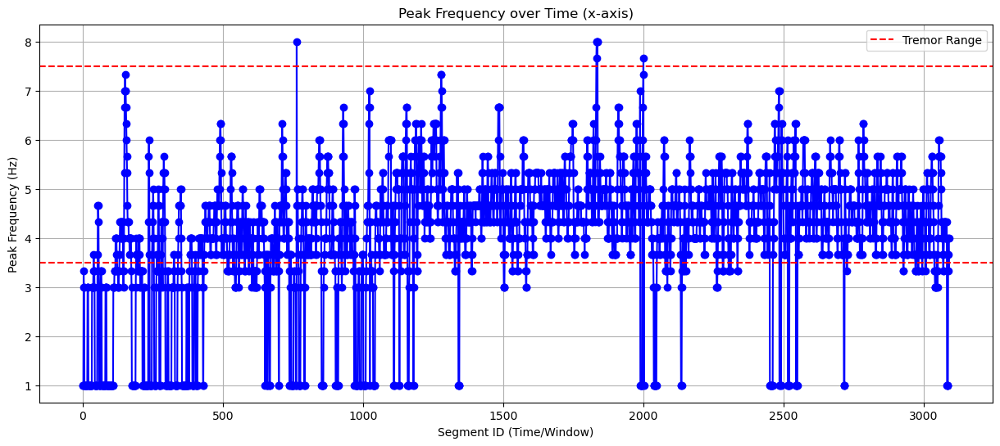

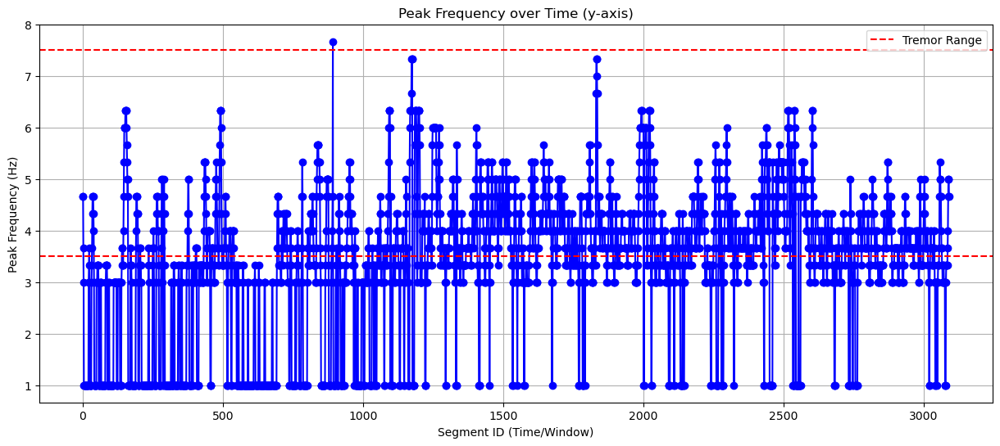

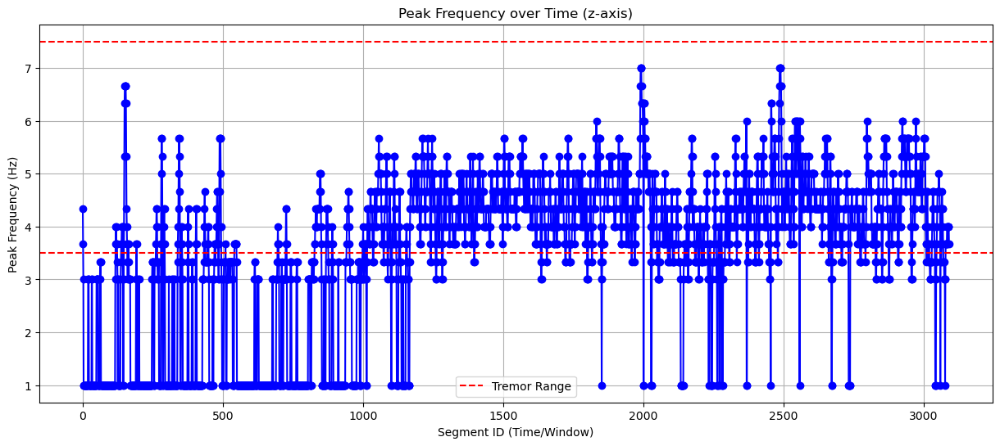

In [20]:
if 'df_features' in locals() and df_features is not None:
    
    # Loop through each axis
    for axis in ['x', 'y', 'z']:
        # Filter the DataFrame for the current axis
        df_current_axis = df_features[df_features['axis'] == axis].copy()
        
        plt.figure(figsize=(15, 6))
        
        # Plot the peak frequencies over time
        plt.plot(df_current_axis['segment_id'], df_current_axis['peak_freq_Hz'], marker='o', linestyle='-', color='blue')
        
        # Add horizontal lines for the tremor frequency range
        plt.axhline(y=3.5, color='red', linestyle='--', label='Tremor Range')
        plt.axhline(y=7.5, color='red', linestyle='--')
        
        plt.title(f'Peak Frequency over Time ({axis}-axis)')
        plt.xlabel('Segment ID (Time/Window)')
        plt.ylabel('Peak Frequency (Hz)')
        plt.legend()
        plt.grid(True)
        plt.show()

In [21]:
print(df_features[df_features['label'] == 'non-tremor'])

      segment_id axis  peak_freq_Hz  peak_power       label
0              0    x           1.0         NaN  non-tremor
1              1    x           1.0         NaN  non-tremor
2              2    x           1.0         NaN  non-tremor
6              6    x           1.0         NaN  non-tremor
7              7    x           1.0         NaN  non-tremor
...          ...  ...           ...         ...         ...
9223        3041    z           1.0         NaN  non-tremor
9224        3042    z           1.0         NaN  non-tremor
9225        3043    z           1.0         NaN  non-tremor
9241        3059    z           1.0         NaN  non-tremor
9258        3076    z           1.0         NaN  non-tremor

[1664 rows x 5 columns]


In [23]:
print(df_features[df_features['label'] == 'tremor'])

      segment_id axis  peak_freq_Hz    peak_power   label
3              3    x      3.333333  4.791050e+09  tremor
4              4    x      3.000000  8.571837e+09  tremor
5              5    x      3.000000  1.347587e+10  tremor
17            17    x      3.000000  1.219224e+10  tremor
18            18    x      3.000000  1.114895e+10  tremor
...          ...  ...           ...           ...     ...
9268        3086    z      3.666667  1.881440e+08  tremor
9269        3087    z      4.000000  2.090844e+08  tremor
9270        3088    z      4.000000  2.106365e+08  tremor
9271        3089    z      4.000000  2.029591e+08  tremor
9272        3090    z      3.666667  2.108777e+08  tremor

[7609 rows x 5 columns]


In [24]:
from IPython.display import display, HTML

# Display the df_features DataFrame inside a scrolling div
display(HTML(
    '<div style="height: 300px; overflow: auto; width: 100%;">'
    + df_features.to_html() +
    '</div>'
))

,segment_id,axis,peak_freq_Hz,peak_power,label
0,0,x,1.000000,NaN,non-tremor
1,1,x,1.000000,NaN,non-tremor
2,2,x,1.000000,NaN,non-tremor
3,3,x,3.333333,4.791050e+09,tremor
4,4,x,3.000000,8.571837e+09,tremor
5,5,x,3.000000,1.347587e+10,tremor
6,6,x,1.000000,NaN,non-tremor
7,7,x,1.000000,NaN,non-tremor
8,8,x,1.000000,NaN,non-tremor
9,9,x,1.000000,NaN,non-tremor


In [22]:
# 2. Refine the labels based on the threshold
# A window is now only a 'tremor' if it was initially labeled 'tremor' AND its peak power
# is above the calculated threshold.
df_features_final = df_features.copy()
df_features_final['final_label'] = 'non-tremor'

for axis in ['x', 'y', 'z']:
    axis_data = df_features_final[df_features_final['axis'] == axis]
    max_peak_power = axis_data['peak_power'].max()
    threshold = max_peak_power / 10
    print(f"Axis: {axis}, Max Peak Power: {max_peak_power:.4f}, Threshold: {threshold:.4f}")

    df_features_final.loc[
        (df_features_final['axis'] == axis) & 
        (df_features_final['label'] == 'tremor') & 
        (df_features_final['peak_power'] > threshold), 
        'final_label'
    ] = 'tremor'

df_features_final.loc[(df_features_final['final_label'] == 'non-tremor'), 'peak_freq_Hz'] = 1
df_features_final.drop(columns=['label','peak_power'], inplace=True)

print("Power thresholding complete. The 'final_label' column is the final window labels.")
print("Number of tremor windows detected:", len(df_features_final[df_features_final['final_label'] == 'tremor']))
print("Number of non-tremor windows detected:", len(df_features_final[df_features_final['final_label'] == 'non-tremor']))
print("\nFirst 10 rows of the refined DataFrame:")
print(df_features_final.head(10))

Axis: x, Max Peak Power: 481339059850.5035, Threshold: 48133905985.0503
Axis: y, Max Peak Power: 1751640955865.1914, Threshold: 175164095586.5191
Axis: z, Max Peak Power: 331144325132.7318, Threshold: 33114432513.2732
Power thresholding complete. The 'final_label' column is the final window labels.
Number of tremor windows detected: 88
Number of non-tremor windows detected: 9185

First 10 rows of the refined DataFrame:
   segment_id axis  peak_freq_Hz final_label
0           0    x           1.0  non-tremor
1           1    x           1.0  non-tremor
2           2    x           1.0  non-tremor
3           3    x           1.0  non-tremor
4           4    x           1.0  non-tremor
5           5    x           1.0  non-tremor
6           6    x           1.0  non-tremor
7           7    x           1.0  non-tremor
8           8    x           1.0  non-tremor
9           9    x           1.0  non-tremor


In [23]:
# We assume df_features_final is a DataFrame with the 'peak_freq_Hz' column.

if 'df_features_final' in locals() and df_features_final is not None:
    # Filter the DataFrame to get all rows where the frequency is not 1.0
    df_tremor_events = df_features_final[df_features_final['peak_freq_Hz'] != 1.0]

    # Print the consecutive rows
    if not df_tremor_events.empty:
        print("Consecutive rows with peak_freq_Hz not equal to 1.0:")
        print(df_tremor_events)
    else:
        print("No rows found where peak_freq_Hz is not equal to 1.0.")

Consecutive rows with peak_freq_Hz not equal to 1.0:
      segment_id axis  peak_freq_Hz final_label
119          119    x      4.000000      tremor
120          120    x      4.000000      tremor
121          121    x      3.666667      tremor
122          122    x      3.666667      tremor
123          123    x      3.333333      tremor
...          ...  ...           ...         ...
6509         327    z      3.000000      tremor
6944         762    z      3.000000      tremor
6945         763    z      3.333333      tremor
6946         764    z      3.333333      tremor
6947         765    z      3.333333      tremor

[88 rows x 4 columns]


In [27]:
# Display the df_features DataFrame inside a scrolling div
display(HTML(
    '<div style="height: 300px; overflow: auto; width: 100%;">'
    + df_features_final.to_html() +
    '</div>'
))

,segment_id,axis,peak_freq_Hz,final_label
0,0,x,1.000000,non-tremor
1,1,x,1.000000,non-tremor
2,2,x,1.000000,non-tremor
3,3,x,1.000000,non-tremor
4,4,x,1.000000,non-tremor
5,5,x,1.000000,non-tremor
6,6,x,1.000000,non-tremor
7,7,x,1.000000,non-tremor
8,8,x,1.000000,non-tremor
9,9,x,1.000000,non-tremor


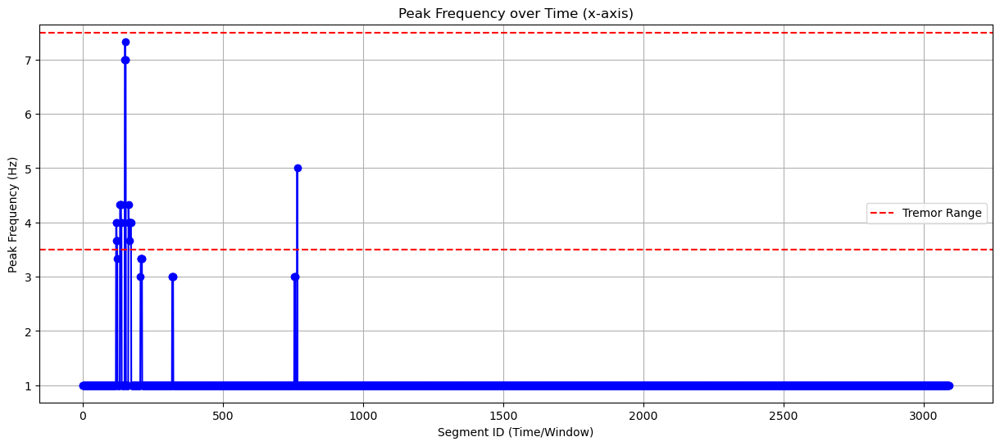

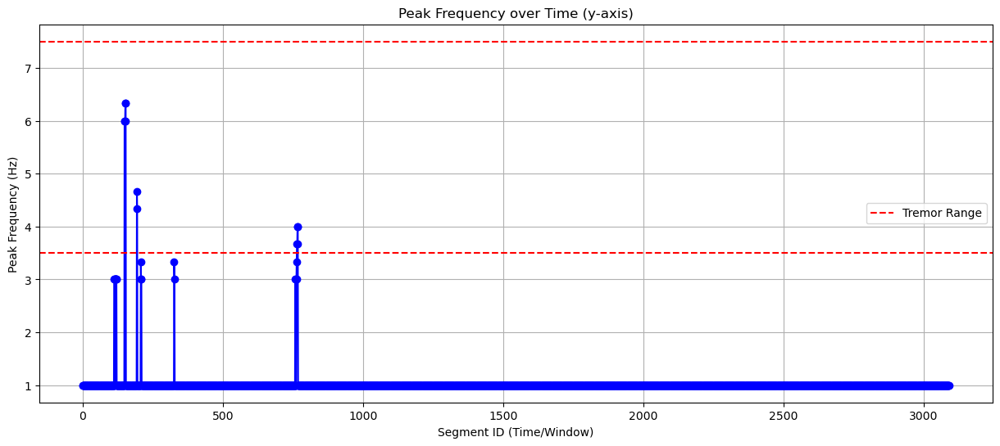

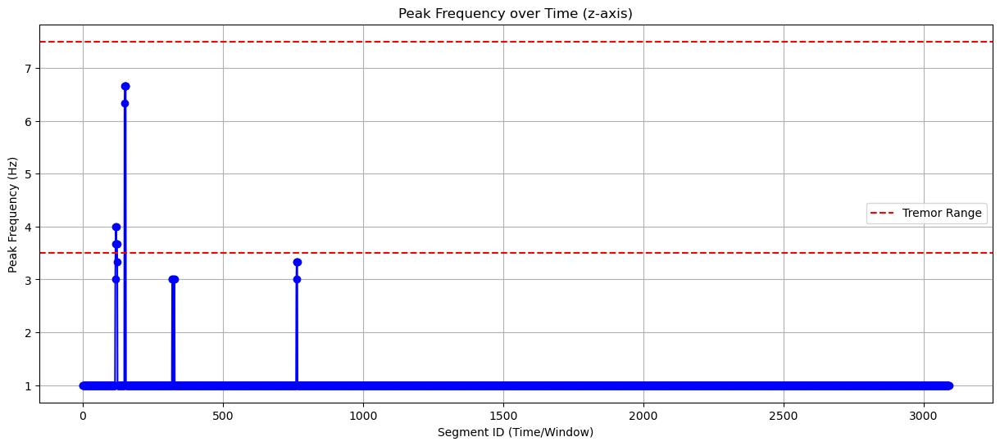

In [24]:
if 'df_features_final' in locals() and df_features_final is not None:
    
    # Loop through each axis
    for axis in ['x', 'y', 'z']:
        # Filter the DataFrame for the current axis
        df_current_axis = df_features_final[df_features_final['axis'] == axis].copy()
        
        plt.figure(figsize=(15, 6))
        
        # Plot the peak frequencies over time
        plt.plot(df_current_axis['segment_id'], df_current_axis['peak_freq_Hz'], marker='o', linestyle='-', color='blue')
        
        # Add horizontal lines for the tremor frequency range
        plt.axhline(y=3.5, color='red', linestyle='--', label='Tremor Range')
        plt.axhline(y=7.5, color='red', linestyle='--')
        
        plt.title(f'Peak Frequency over Time ({axis}-axis)')
        plt.xlabel('Segment ID (Time/Window)')
        plt.ylabel('Peak Frequency (Hz)')
        plt.legend()
        plt.grid(True)
        plt.show()

# Apporach 2: Upsamples first step 6 to end in the literature

## Caution

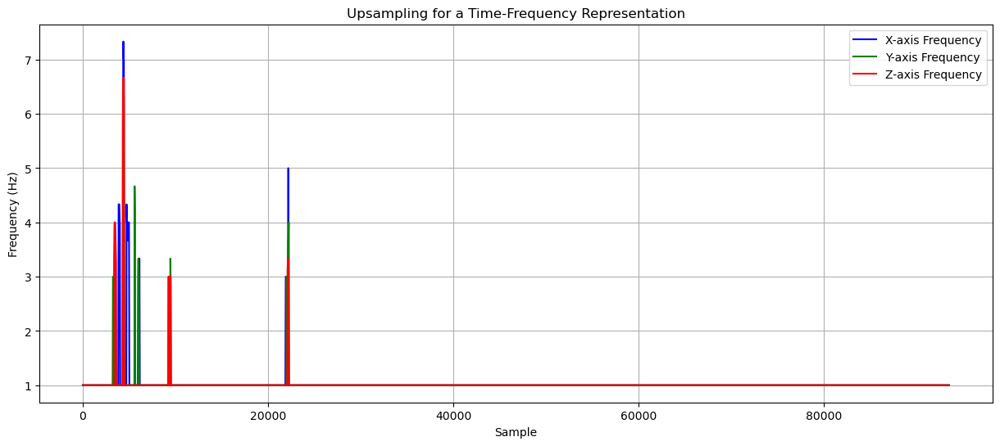

In [26]:
# We assume df_final_features, df_accel, window_samples, and step_samples are available.
if 'df_features_final' in locals() and df_features_final is not None and 'df_accel' in locals() and df_accel is not None:
    
    # Corrected: Original time points should be the start of each window
    original_time_points = df_features_final[df_features_final['axis'] == 'x']['segment_id'].values * step_samples
    
    # Get the frequency data to be upsampled
    data_x_freq = df_features_final[df_features_final['axis'] == 'x']['peak_freq_Hz'].values
    data_y_freq = df_features_final[df_features_final['axis'] == 'y']['peak_freq_Hz'].values
    data_z_freq = df_features_final[df_features_final['axis'] == 'z']['peak_freq_Hz'].values
    
    # Create the new, upsampled time axis
    total_samples = len(df_accel)
    new_time_axis = np.arange(total_samples)

    # 2. Perform the ZOH interpolation for EACH AXIS
    upsampled_x = np.interp(new_time_axis, original_time_points, data_x_freq, right=data_x_freq[-1])
    upsampled_y = np.interp(new_time_axis, original_time_points, data_y_freq, right=data_y_freq[-1])
    upsampled_z = np.interp(new_time_axis, original_time_points, data_z_freq, right=data_z_freq[-1])

    # 3. Plot the result
    plt.figure(figsize=(15, 6))
    plt.plot(upsampled_x, label='X-axis Frequency', color='blue')
    plt.plot(upsampled_y, label='Y-axis Frequency', color='green')
    plt.plot(upsampled_z, label='Z-axis Frequency', color='red')
    
    plt.title('Upsampling for a Time-Frequency Representation')
    plt.xlabel('Sample')
    plt.ylabel('Frequency (Hz)')
    plt.grid(True)
    plt.legend()
    plt.show()

In [40]:
upsampled_x[:10]

array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

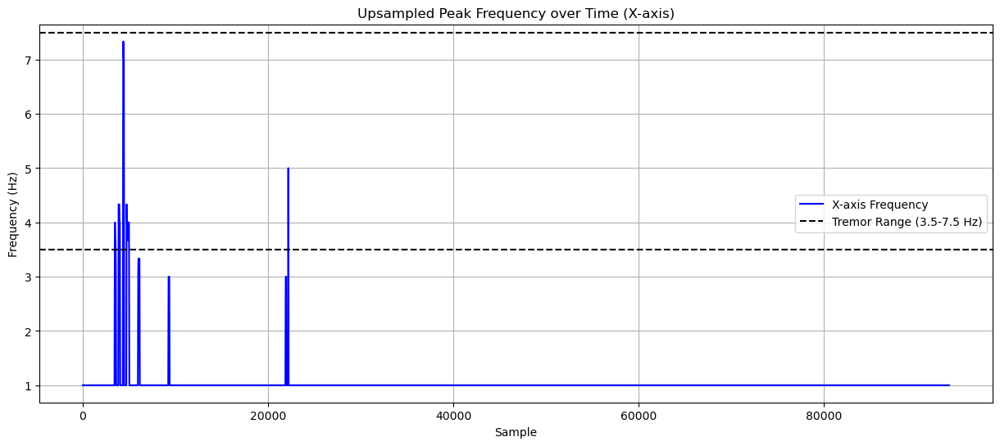

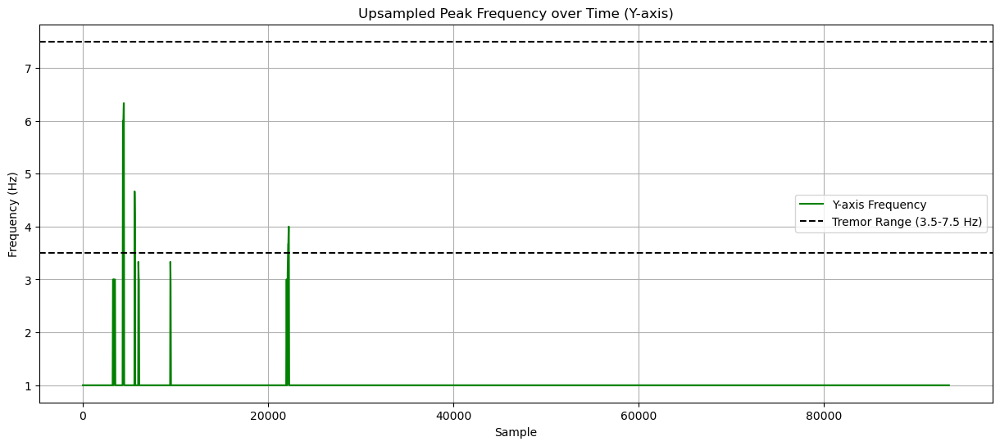

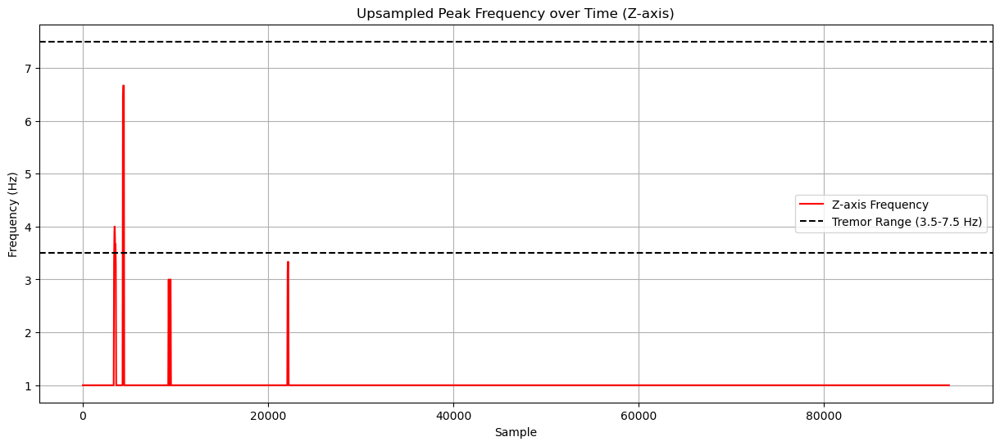

In [27]:
# Assuming upsampled_x, upsampled_y, and upsampled_z are available from a previous step.
if 'upsampled_x' in locals() and upsampled_x is not None:
    
    # Create the time axis
    total_samples = len(upsampled_x)
    new_time_axis = np.arange(total_samples)
    
    # Loop through each axis and plot separately
    for axis, upsampled_data, color in zip(
        ['X', 'Y', 'Z'], 
        [upsampled_x, upsampled_y, upsampled_z], 
        ['blue', 'green', 'red']
    ):
        plt.figure(figsize=(15, 6))
        
        # Plot the upsampled frequency
        plt.plot(new_time_axis, upsampled_data, label=f'{axis}-axis Frequency', color=color)
        
        # Add horizontal lines for the tremor frequency range
        plt.axhline(y=3.5, color='black', linestyle='--', label='Tremor Range (3.5-7.5 Hz)')
        plt.axhline(y=7.5, color='black', linestyle='--')
        
        plt.title(f'Upsampled Peak Frequency over Time ({axis}-axis)')
        plt.xlabel('Sample')
        plt.ylabel('Frequency (Hz)')
        plt.grid(True)
        plt.legend()
        plt.show()

In [28]:
if 'upsampled_x' in locals() and upsampled_x is not None:
    
    # Create the new DataFrame df_upsampled_freq
    df_upsampled_freq = pd.DataFrame({
        'x_freq': upsampled_x,
        'y_freq': upsampled_y,
        'z_freq': upsampled_z
    })

In [29]:
display(HTML(
    '<div style="height: 300px; overflow: auto; width: 100%;">'
    + df_upsampled_freq.to_html() +
    '</div>'
))

NameError: name 'HTML' is not defined

In [30]:
if 'df_upsampled_freq' in locals() and df_upsampled_freq is not None:
    
    # Create a new DataFrame to hold the smoothed frequency data
    df_smoothed_freq = pd.DataFrame(index=df_upsampled_freq.index)
    moving_average_window = 300
    
    # Loop through each frequency column and apply the moving average filter
    for col in df_upsampled_freq.columns:
        df_smoothed_freq[col] = df_upsampled_freq[col].rolling(
            window=moving_average_window, center=True
        ).mean().fillna(0)

    # Multiply the smoothed frequency columns to create a new 'combined' column
    df_smoothed_freq['combined'] = df_smoothed_freq['x_freq'] * df_smoothed_freq['y_freq'] * df_smoothed_freq['z_freq']
    
    # Apply the threshold of 3.5 to the combined frequency
    df_smoothed_freq['tremor'] = (df_smoothed_freq['combined'] > 3.5).astype(int)

In [34]:
display(HTML(
    '<div style="height: 300px; overflow: auto; width: 100%;">'
    + df_smoothed_freq.to_html() +
    '</div>'
))

,x_freq,y_freq,z_freq,combined,tremor
0,0.000000,0.000000,0.000000,0.000000,0
1,0.000000,0.000000,0.000000,0.000000,0
2,0.000000,0.000000,0.000000,0.000000,0
3,0.000000,0.000000,0.000000,0.000000,0
4,0.000000,0.000000,0.000000,0.000000,0
5,0.000000,0.000000,0.000000,0.000000,0
6,0.000000,0.000000,0.000000,0.000000,0
7,0.000000,0.000000,0.000000,0.000000,0
8,0.000000,0.000000,0.000000,0.000000,0
9,0.000000,0.000000,0.000000,0.000000,0


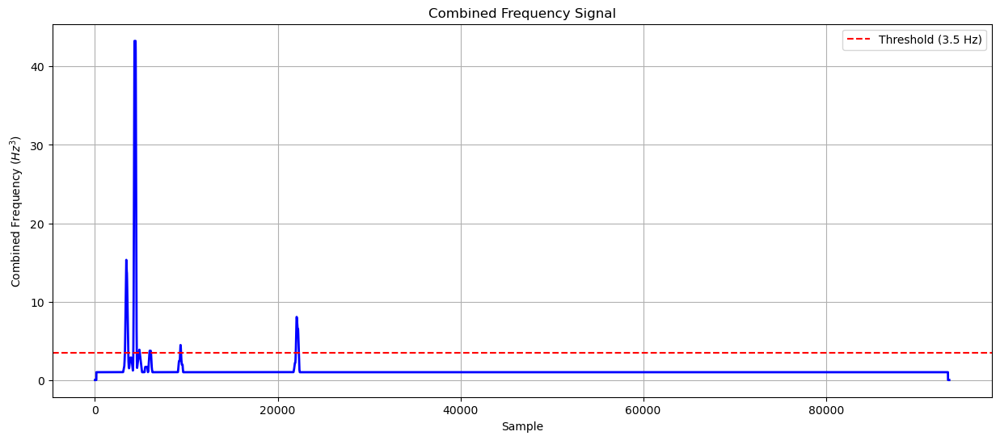

In [31]:
if 'df_smoothed_freq' in locals() and df_smoothed_freq is not None:
    
    plt.figure(figsize=(15, 6))
    
    # Plot the 'combined' column
    plt.plot(df_smoothed_freq['combined'], color='blue', linewidth=2)
    
    # Add a horizontal line to mark the threshold
    plt.axhline(y=3.5, color='red', linestyle='--', label='Threshold (3.5 Hz)')
    
    plt.title('Combined Frequency Signal')
    plt.xlabel('Sample')
    plt.ylabel('Combined Frequency ($Hz^3$)')
    plt.grid(True)
    plt.legend()
    plt.show()

In [32]:
if 'df_smoothed_freq' in locals() and df_smoothed_freq is not None:
    
    # Identify the start and end indices of tremor events
    tremor_pulse = df_smoothed_freq['tremor'].values
    start_indices = np.where(np.diff(tremor_pulse, prepend=0) == 1)[0]
    end_indices = np.where(np.diff(tremor_pulse, append=0) == -1)[0]
    
    # Assume a sampling rate of 100 Hz
    fs = 100.0
    
    # Create a list to store the valid tremor events
    valid_tremor_events = []
    
    for start, end in zip(start_indices, end_indices):
        duration_in_seconds = (end - start) / fs
        
        # Check if the duration is greater than 3 seconds
        if duration_in_seconds > 3:
            valid_tremor_events.append({
                'start_sample': start,
                'end_sample': end,
                'duration_s': duration_in_seconds
            })
            
    df_long_tremors = pd.DataFrame(valid_tremor_events)

    print("New DataFrame 'df_long_tremors' created successfully.")
    print("It contains only the tremor events with a duration greater than 3 seconds.")
    print("\nFirst 10 rows of the new DataFrame:")
    print(df_long_tremors.head(10))

New DataFrame 'df_long_tremors' created successfully.
It contains only the tremor events with a duration greater than 3 seconds.

First 10 rows of the new DataFrame:
   start_sample  end_sample  duration_s
0          3279        3636        3.57
1          4197        4577        3.80
2         21978       22310        3.32


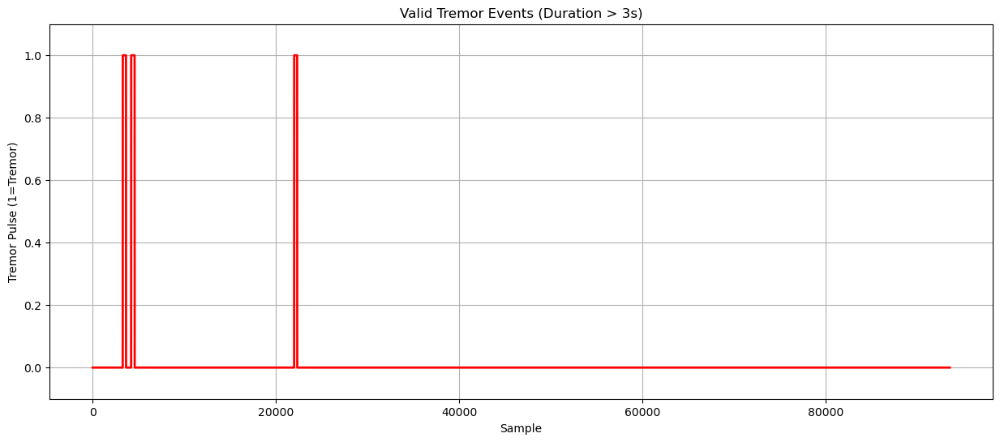

In [33]:
if 'df_long_tremors' in locals() and df_long_tremors is not None and 'df_accel' in locals() and df_accel is not None:
    
    # Create a new DataFrame to hold the tremor pulse
    total_samples = len(df_accel)
    df_tremor_pulse = pd.DataFrame({'tremor': np.zeros(total_samples)}, index=np.arange(total_samples))
    
    # Set the values to 1 for the duration of the valid tremor events
    for _, row in df_long_tremors.iterrows():
        start = int(row['start_sample'])
        end = int(row['end_sample'])
        df_tremor_pulse.loc[start:end, 'tremor'] = 1
        
    # Plot the tremor pulse
    plt.figure(figsize=(15, 6))
    plt.plot(df_tremor_pulse['tremor'], color='red', linewidth=2)
    
    plt.title('Valid Tremor Events (Duration > 3s)')
    plt.xlabel('Sample')
    plt.ylabel('Tremor Pulse (1=Tremor)')
    plt.ylim(-0.1, 1.1)
    plt.grid(True)
    plt.show()

In [34]:
# Find the index of the maximum value in the 'combined' column
max_index_label = df_smoothed_freq['combined'].idxmax()

# Use the index label to retrieve the entire row
row_with_max_combined_freq = df_smoothed_freq.loc[max_index_label]

print("Row with the maximum combined frequency:")
print(row_with_max_combined_freq)

Row with the maximum combined frequency:
x_freq       3.352222
y_freq       3.481111
z_freq       3.706667
combined    43.254791
tremor       1.000000
Name: 4316, dtype: float64


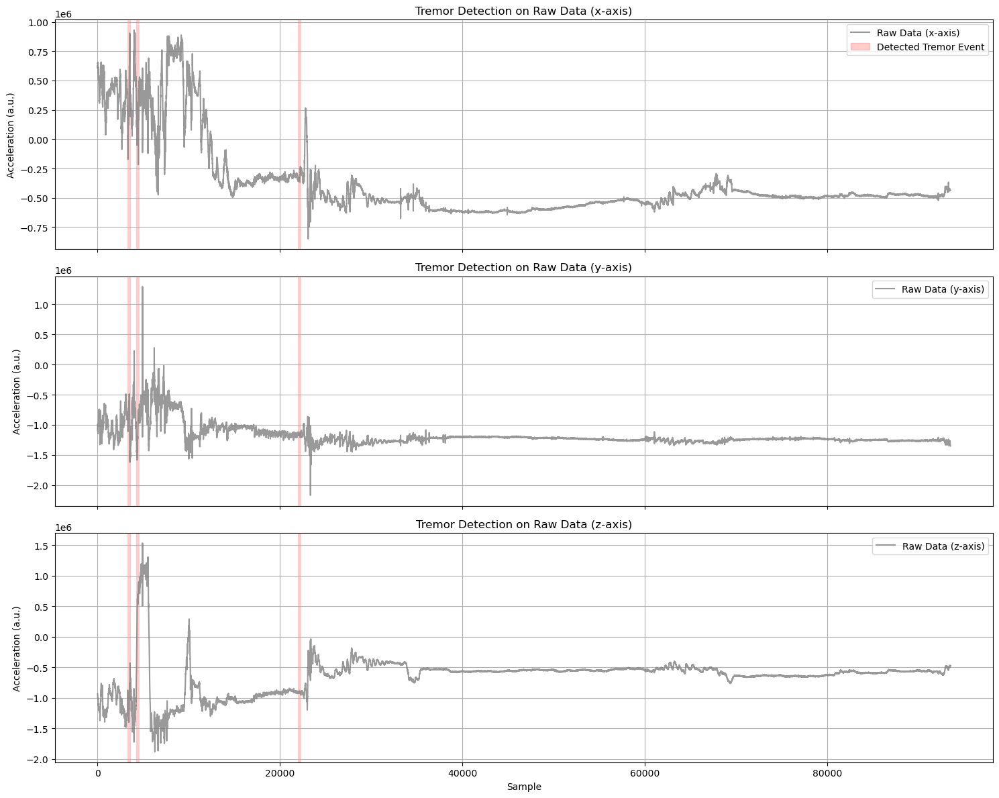

In [35]:
import matplotlib.patches as patches

# We assume df_accel and df_long_tremors are available from previous steps.
if 'df_accel' in locals() and df_accel is not None and 'df_long_tremors' in locals() and df_long_tremors is not None:
    
    fig, axes = plt.subplots(3, 1, figsize=(15, 12), sharex=True)
    
    for i, axis in enumerate(['x', 'y', 'z']):
        ax = axes[i]
        
        # Plot the raw accelerometer data
        ax.plot(df_accel[axis], label=f'Raw Data ({axis}-axis)', color='gray', alpha=0.8)
        
        # Get the min and max y-values for the shaded region
        y_min, y_max = ax.get_ylim()

        # Iterate through the df_long_tremors and shade the detected tremor regions
        for _, row in df_long_tremors.iterrows():
            start_sample = row['start_sample']
            end_sample = row['end_sample']
            
            # Create a shaded rectangle for the tremor duration
            rect = patches.Rectangle(
                (start_sample, y_min), 
                end_sample - start_sample, 
                y_max - y_min, 
                linewidth=0, 
                facecolor='red', 
                alpha=0.2, 
                label='_nolegend_'
            )
            ax.add_patch(rect)
            
        ax.set_title(f'Tremor Detection on Raw Data ({axis}-axis)')
        ax.set_ylabel('Acceleration (a.u.)')
        ax.grid(True)
        ax.legend()
    
    # Create a dummy patch for the legend
    red_patch = patches.Patch(color='red', alpha=0.2, label='Detected Tremor Event')
    axes[0].legend(handles=[axes[0].lines[0], red_patch])
    
    plt.xlabel('Sample')
    plt.tight_layout()
    plt.show()

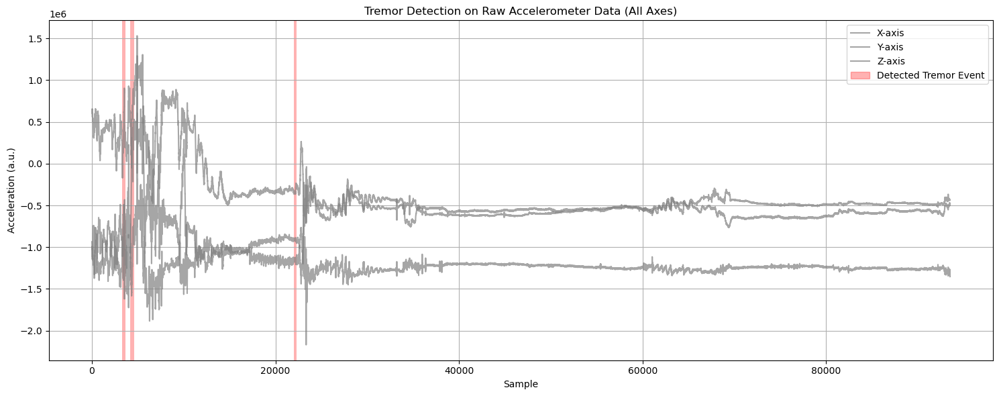

In [36]:
if 'df_accel' in locals() and df_accel is not None and 'df_long_tremors' in locals() and df_long_tremors is not None:
    
    fig, ax = plt.subplots(figsize=(15, 6))
    
    # Plot the raw accelerometer data for all three axes
    ax.plot(df_accel['x'], label='X-axis', color='gray', alpha=0.7)
    ax.plot(df_accel['y'], label='Y-axis', color='gray', alpha=0.7)
    ax.plot(df_accel['z'], label='Z-axis', color='gray', alpha=0.7)
    
    # Get the min and max y-values for the shaded region
    y_min, y_max = ax.get_ylim()
    
    # Iterate through the df_long_tremors and shade the detected tremor regions
    for _, row in df_long_tremors.iterrows():
        start_sample = row['start_sample']
        end_sample = row['end_sample']
        
        # Create a shaded rectangle for the tremor duration
        rect = patches.Rectangle(
            (start_sample, y_min), 
            end_sample - start_sample, 
            y_max - y_min, 
            linewidth=0, 
            facecolor='red', 
            alpha=0.3
        )
        ax.add_patch(rect)

    # Create a dummy patch for the legend
    gray_patch = patches.Patch(color='red', alpha=0.3, label='Detected Tremor Event')
    ax.legend(handles=[ax.lines[0], ax.lines[1], ax.lines[2], gray_patch])
    
    ax.set_title('Tremor Detection on Raw Accelerometer Data (All Axes)')
    ax.set_xlabel('Sample')
    ax.set_ylabel('Acceleration (a.u.)')
    ax.grid(True)
    
    plt.tight_layout()
    plt.show()

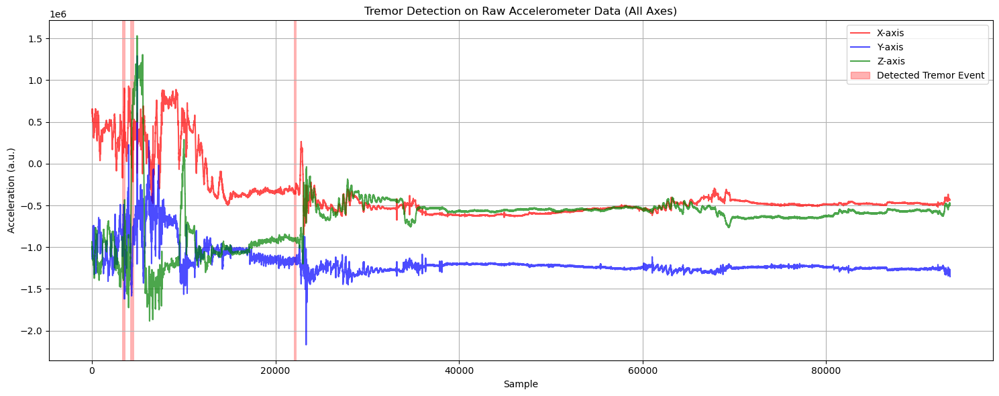

In [37]:
if 'df_accel' in locals() and df_accel is not None and 'df_long_tremors' in locals() and df_long_tremors is not None:
    
    fig, ax = plt.subplots(figsize=(15, 6))
    
    # Plot the raw accelerometer data for all three axes
    ax.plot(df_accel['x'], label='X-axis', color='red', alpha=0.7)
    ax.plot(df_accel['y'], label='Y-axis', color='blue', alpha=0.7)
    ax.plot(df_accel['z'], label='Z-axis', color='green', alpha=0.7)
    
    # Get the min and max y-values for the shaded region
    y_min, y_max = ax.get_ylim()
    
    # Iterate through the df_long_tremors and shade the detected tremor regions
    for _, row in df_long_tremors.iterrows():
        start_sample = row['start_sample']
        end_sample = row['end_sample']
        
        # Create a shaded rectangle for the tremor duration
        rect = patches.Rectangle(
            (start_sample, y_min), 
            end_sample - start_sample, 
            y_max - y_min, 
            linewidth=0, 
            facecolor='red', 
            alpha=0.3
        )
        ax.add_patch(rect)

    # Create a dummy patch for the legend
    gray_patch = patches.Patch(color='red', alpha=0.3, label='Detected Tremor Event')
    ax.legend(handles=[ax.lines[0], ax.lines[1], ax.lines[2], gray_patch])
    
    ax.set_title('Tremor Detection on Raw Accelerometer Data (All Axes)')
    ax.set_xlabel('Sample')
    ax.set_ylabel('Acceleration (a.u.)')
    ax.grid(True)
    
    plt.tight_layout()
    plt.show()

### Notes

Some parameters we should take into consideration

Parameters known to directly affect the final tremor detection;
- The peak power threshold applied to "potentially tremor" windows currently at T = Max power/1000. Default literature T = Max power/10 (Step 5).
- The moving average window at for the frequency smoothing (Step 7).

Other parameters to consider: 
- Drift removal window currently set at 500 (Step 1)
- FIR Bandpass filter order currently set at 100 (Step 2)

# Old codes tested, not used in the pipeline